# Load both ATAC and RNA data

In [1]:
import scanpy as sc
import scanpy.external as sce

import MultiMAP
import SEACells
#import bbknn

from sklearn.feature_extraction.text import TfidfTransformer

import pandas as pd
import numpy as np
import gc

import IProgress
import ipywidgets

import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

pd.set_option('display.max_columns', 100)

In [3]:
# Import processed scRNA-seq data
#rna = sc.read('../data/rna/scRNA_batch1_2.processed.h5ad')

# Load gene expression with only fibroblasts
rna = sc.read('../data/rna/scRNA_batch1_2.processed.fibroblasts.h5ad')

Only considering the two last: ['.fibroblasts', '.h5ad'].
Only considering the two last: ['.fibroblasts', '.h5ad'].


In [4]:
rna

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap'
    obsm: 'X_pca'

In [5]:
rna.obs.sample_id

index
AAACCCATCGTGCTCT-R01    R01
AAACGAACATGTTACG-R01    R01
AAACGAAGTTCCGTTC-R01    R01
AAACGCTGTCGTTGGC-R01    R01
AAAGAACCACAAGGTG-R01    R01
                       ... 
TTTGGTTCATTCGATG-R13    R13
TTTGGTTGTACTAGCT-R13    R13
TTTGGTTTCGTGGACC-R13    R13
TTTGTTGGTCACTACA-R13    R13
TTTGTTGTCCTCTTTC-R13    R13
Name: sample_id, Length: 26727, dtype: category
Categories (13, object): ['R01', 'R02', 'R03', 'R04', ..., 'R10', 'R11', 'R12', 'R13']

In [6]:
#rna.obsm['X_pca'].shape

In [7]:
#print(subsampleX[1:10, 1:10])

In [8]:
rna.obs.annot1.value_counts()

annot1
S3     8295
S1     5644
S3x    3175
S5     3103
S2     3029
MF1    1401
PC     1200
S4      699
MF2     181
Name: count, dtype: int64

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


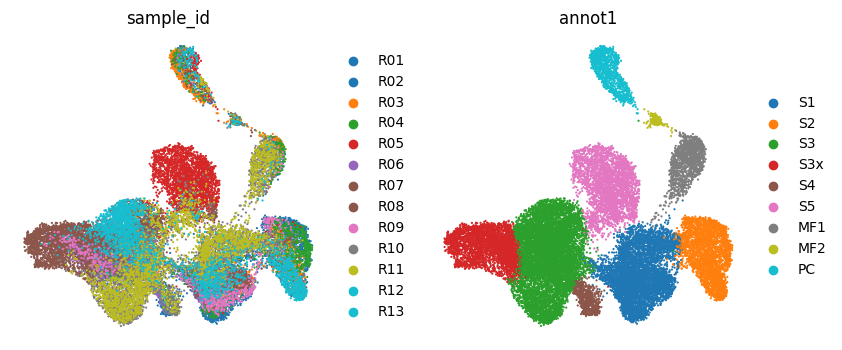

In [9]:
# Plot UMAP to see if data is the same
sc.pl.umap(
    rna,
    color=['sample_id', 'annot1'],
    palette='tab10',
    frameon=False,
    size=10,  # point size
    #add_outline=True
    #legend_loc='on data',
    #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
)

In [10]:
# Load ATAC data by peaks
#atac = sc.read('../fibroblast_reanalysis/data/scATAC_PeakMatrix_fibro.processed.h5ad')


In [11]:
#Load ATAC data as gene score matrix
atac = sc.read('../data/atac/scATAC_GeneScoreMatrix.cellxgene.h5ad')

#Set index to gene symbol -- for integration purposes(?)
atac.var.index = atac.var.name

In [12]:
atac

AnnData object with n_obs × n_vars = 77712 × 24919
    obs: 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'Sample', 'TSSEnrichment', 'Clusters', 'predictedCell_Un', 'predictedGroup_Un', 'predictedScore_Un', 'predictedCell_Co', 'predictedGroup_Co', 'predictedScore_Co', 'Clusters_hm', 'predictedCell_Un_hm', 'predictedGroup_Un_hm', 'predictedScore_Un_hm', 'predictedCell_Co_hm', 'predictedGroup_Co_hm', 'predictedScore_Co_hm', 'predictedCell', 'predictedGroup', 'predictedScore', 'Annot', 'annot1'
    var: 'seqnames', 'start', 'end', 'strand', 'name', 'idx'
    obsm: 'X_umap'

In [13]:
atac.obs['sample_id'] = atac.obs.Sample  # column harmonization with RNA

In [14]:
#atac.obs.annot1.value_counts()

In [15]:
atac.var

,seqnames,start,end,strand,name,idx
name,,,,,,
OR4F5,chr1,69091,70008,1,OR4F5,1
LOC729737,chr1,140339,139790,2,LOC729737,2
LOC101928626,chr1,629010,585990,2,LOC101928626,3
FAM87B,chr1,817371,819837,1,FAM87B,4
LINC01128,chr1,825138,859446,1,LINC01128,5
...,...,...,...,...,...,...
RAB39B,chrX,155264589,155258241,2,RAB39B,952
CLIC2,chrX,155334657,155276211,2,CLIC2,953
H2AFB1,chrX,155380787,155381134,1,H2AFB1,954


## Load peak set dimensionality reduction

In [16]:
# Load peak dimensionality reduction from ArchR
lsi_mat = pd.read_csv("data/atac_IterativeLSI.csv", index_col=0)
lsi_harmony_mat = pd.read_csv("data/atac_IterativeLSI_harmony.csv", index_col=0)

In [17]:
lsi_mat.index

Index(['NX02#TGCATGAGTACCTATG-1', 'NX02#GCAGCTGCATGGAGGT-1',
       'NX02#ACATGGTCACAAGGGT-1', 'NX02#GCGTTGGCAACGTCGC-1',
       'NX02#CACAGATTCGAGGCTC-1', 'NX02#CCTTAATTCAGGAATA-1',
       'NX02#GGGCCATTCCCACTTG-1', 'NX02#GGCGTTGGTGCTTGAT-1',
       'NX02#CGGACCACACAAGGGT-1', 'NX02#TCAAGCATCTATCTAC-1',
       ...
       'A13#CAATCCCAGCAAGGTC-1', 'A13#GCCAGACGTCAGACGA-1',
       'A13#CACGTTCGTTATCGAC-1', 'A13#CCTGGGAAGGCCAGTA-1',
       'A13#GAGCGCTTCCGGCGAT-1', 'A13#ATGTCTTGTCTGAGCC-1',
       'A13#TAGCACATCCAATCCC-1', 'A13#CCACAGGCAGAACAGC-1',
       'A13#CGCTATCGTGTAGGAC-1', 'A13#TAACGGTTCGGATAAA-1'],
      dtype='object', length=86161)

In [18]:
atac.obs.index

Index(['A11#GGACACCCAAGCCTTA-1', 'A11#AACTGGTAGCGCCTAC-1',
       'A11#AACGAGGGTTTGCCAA-1', 'A11#GCAACCGGTGGTACTT-1',
       'A11#TTACGTTAGCATACCT-1', 'A11#AACAAAGGTGCCCTAG-1',
       'A11#ATTCGTTGTCGAGAAC-1', 'A11#TGGCGCACACCCATCT-1',
       'A11#CAACGTATCCGGAAAG-1', 'A11#ATGGATCGTCTGCACG-1',
       ...
       'A08#AGCCTTCGTCGATAGG-1', 'A08#TAGCCCTGTTTGTCTT-1',
       'A08#AACGGGACATCATCGA-1', 'A08#CACTAAGTCCGCTATC-1',
       'A08#AGCTGTACAAACCTAC-1', 'A08#CACTGAAGTTCCAATG-1',
       'A08#TTAGGTGCATCGGCCA-1', 'A08#CCGTGAGTCGAACACT-1',
       'A08#TGTGGCGGTCAACAGG-1', 'A08#AATGCCAAGAGCGGTT-1'],
      dtype='object', name='index', length=77712)

In [19]:
#np.sum(lsi_mat.index.isin(atac.obs.index))

In [20]:
# Check cell barcode overlap
np.sum(atac.obs.index.isin(lsi_mat.index))

77712

In [21]:
# match index and add to AnnData object
atac.obsm['peak_IterativeLSI'] = lsi_mat.reindex(atac.obs.index)
atac.obsm['peak_IterativeLSI_harmony'] = lsi_harmony_mat.reindex(atac.obs.index)

## Subset cells to fibroblasts

In [22]:
# Subset data
select_cells = ['S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC']
atac = atac[atac.obs.annot1.isin(select_cells)]

atac.obs.annot1 = atac.obs.annot1.cat.add_categories('MF2')  # add missing category (such that coloring scheme aligns with scRNA-seq data)

# Reorder annotation labels
atac.obs.annot1 = atac.obs.annot1.cat.reorder_categories([
    'S1', 'S2', 'S3', 'S3x', 'S4', 'S5', 'MF1', 'MF2', 'PC'  # data does not contain MF2
])

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/pandas/core/generic.py:6018: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  self[name] = value


In [23]:
atac

AnnData object with n_obs × n_vars = 56689 × 24919
    obs: 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'Sample', 'TSSEnrichment', 'Clusters', 'predictedCell_Un', 'predictedGroup_Un', 'predictedScore_Un', 'predictedCell_Co', 'predictedGroup_Co', 'predictedScore_Co', 'Clusters_hm', 'predictedCell_Un_hm', 'predictedGroup_Un_hm', 'predictedScore_Un_hm', 'predictedCell_Co_hm', 'predictedGroup_Co_hm', 'predictedScore_Co_hm', 'predictedCell', 'predictedGroup', 'predictedScore', 'Annot', 'annot1', 'sample_id'
    var: 'seqnames', 'start', 'end', 'strand', 'name', 'idx'
    obsm: 'X_umap', 'peak_IterativeLSI', 'peak_IterativeLSI_harmony'

## Original UMAP plot

In [24]:
atac.obsm['X_umap_ori'] = atac.obsm['X_umap']

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


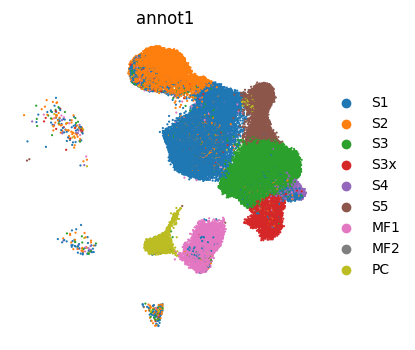

In [25]:
sc.pl.umap(
    atac,
    color='annot1',
    #palette='tab20',
    frameon=False,
    size=10,  # point size
    #add_outline=True
    #legend_loc='on data',
    #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
)

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


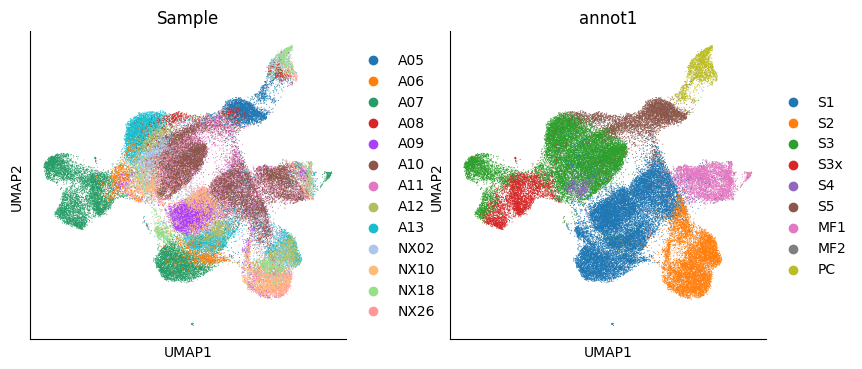

In [26]:
sc.pp.neighbors(atac, use_rep="peak_IterativeLSI")
sc.tl.umap(atac)
sc.pl.umap(atac, color=['Sample', 'annot1'])

In [27]:
# # Integrate samples from LSI dimensionality reduction
# sce.pp.harmony_integrate(atac, key='Sample', basis='peak_IterativeLSI', adjusted_basis='peak_IterativeLSI_harmony2')

In [28]:
# # UMAP
# sc.pp.neighbors(atac, use_rep="peak_IterativeLSI_harmony2")
# sc.tl.umap(atac)
# sc.pl.umap(atac, color=['Sample', 'annot1'])

In [29]:
# atac

In [30]:
#sc.external.pp.bbknn(adata, batch_key='modality', use_rep='X_pca_harmony', )

In [31]:
#atac.obs.Sample

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


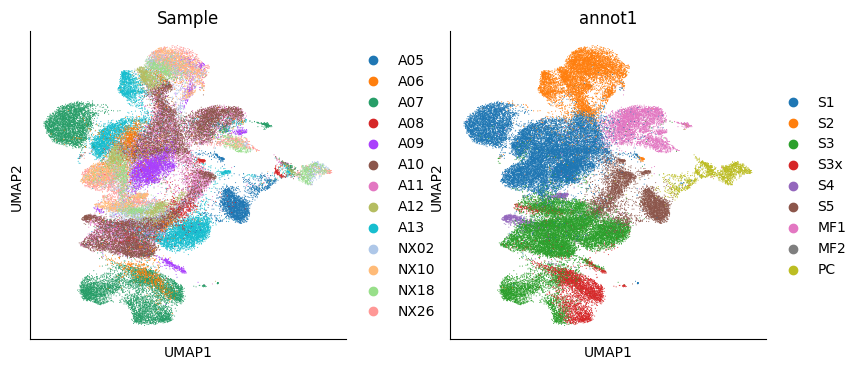

In [32]:
# Plot imported LSI, Harmony integrated
sc.pp.neighbors(atac, use_rep="peak_IterativeLSI_harmony")
sc.tl.umap(atac)
sc.pl.umap(atac, color=['Sample', 'annot1'])

In [33]:
# Multimap implementation of Latent Semantic Indexing (LSI) on ATAC peak data
# Dimensionality reduction, introduced for ATAC data by https://www.science.org/doi/10.1126/science.aab1601
#MultiMAP.TFIDF_LSI(atac)
#MultiMAP.TFIDF_LSI(atac, n_comps=30)

In [34]:
atac

AnnData object with n_obs × n_vars = 56689 × 24919
    obs: 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'Sample', 'TSSEnrichment', 'Clusters', 'predictedCell_Un', 'predictedGroup_Un', 'predictedScore_Un', 'predictedCell_Co', 'predictedGroup_Co', 'predictedScore_Co', 'Clusters_hm', 'predictedCell_Un_hm', 'predictedGroup_Un_hm', 'predictedScore_Un_hm', 'predictedCell_Co_hm', 'predictedGroup_Co_hm', 'predictedScore_Co_hm', 'predictedCell', 'predictedGroup', 'predictedScore', 'Annot', 'annot1', 'sample_id'
    var: 'seqnames', 'start', 'end', 'strand', 'name', 'idx'
    uns: 'annot1_colors', 'neighbors', 'umap', 'Sample_colors'
    obsm: 'X_umap', 'peak_IterativeLSI', 'peak_IterativeLSI_harmony', 'X_umap_ori'
    obsp: 'distances', 'connectivities'

# Recompute PCA on gene score matrix

In [35]:
# Recompute PCA on gene score matrix
sc.tl.pca(atac, n_comps=30)

In [36]:
atac.obsm['X_pca'].shape

(56689, 30)

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


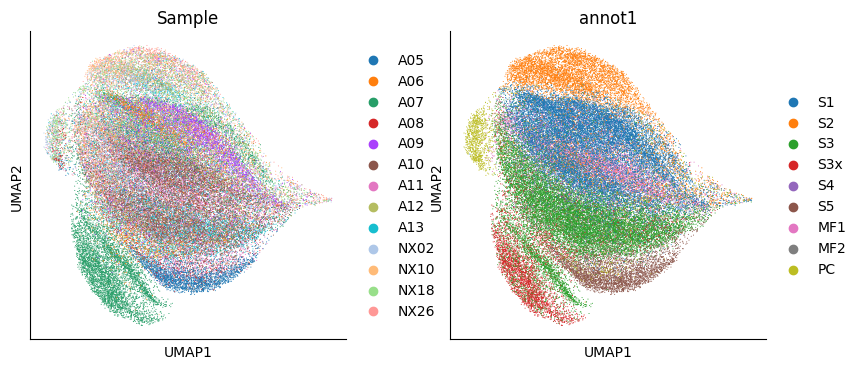

In [37]:
# UMAP of recomputed PCA space
sc.pp.neighbors(atac, use_rep="X_pca")
sc.tl.umap(atac)
sc.pl.umap(atac, color=['Sample', 'annot1'])

In [38]:
# BBKNN batch correction
#sc.external.pp.bbknn(adata, batch_key='Sample', use_rep='X_pca')

In [39]:
# # Harmony integration of samples in gene score space
# sc.external.pp.harmony_integrate(atac, key='Sample')

In [40]:
# sc.pp.neighbors(atac, use_rep="X_pca_harmony")
# sc.tl.umap(atac)
# sc.pl.umap(atac, color=['Sample', 'annot1'])

In [41]:
#atac.obsm['X_pca']

In [42]:
#atac.obsm['X_pca_no1'] = np.delete(atac.obsm['X_pca'], 0, 1)

In [43]:
#atac.obsm['X_pca_no1'].shape

In [44]:
#atac.obsm['X_pca_no1'] = atac.obsm['X_pca'].iloc[:, 1:]

In [45]:
#atac.obs.Sample.value_counts()

In [46]:
# Batch correction,
# PCA per batch
#atac = MultiMAP.Batch(atac, batch_key='Sample')

In [47]:
#atac.obs.Sample

In [48]:
#atac_sub = sc.pp.subsample(atac, fraction=0.25, copy=True)

In [49]:
#atac_sub

In [50]:
rna

AnnData object with n_obs × n_vars = 26727 × 17590
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1'
    var: 'gene_ids', 'mito', 'ribo', 'hb', 'n_counts', 'n_cells', 'cc', 'highly_variable', 'highly_variable_nbatches', 'hvg_full'
    uns: 'annot1_colors', 'leiden', 'neighbors', 'neighbors_bk', 'pca', 'umap', 'sample_id_color

In [51]:
atac

AnnData object with n_obs × n_vars = 56689 × 24919
    obs: 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'Sample', 'TSSEnrichment', 'Clusters', 'predictedCell_Un', 'predictedGroup_Un', 'predictedScore_Un', 'predictedCell_Co', 'predictedGroup_Co', 'predictedScore_Co', 'Clusters_hm', 'predictedCell_Un_hm', 'predictedGroup_Un_hm', 'predictedScore_Un_hm', 'predictedCell_Co_hm', 'predictedGroup_Co_hm', 'predictedScore_Co_hm', 'predictedCell', 'predictedGroup', 'predictedScore', 'Annot', 'annot1', 'sample_id'
    var: 'seqnames', 'start', 'end', 'strand', 'name', 'idx'
    uns: 'annot1_colors', 'neighbors', 'umap', 'Sample_colors', 'pca'
    obsm: 'X_umap', 'peak_IterativeLSI', 'peak_IterativeLSI_harmony', 'X_umap_ori', 'X_pca'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [52]:
#atac.obs

In [53]:
#rna.obs

## MultiMAP integration

In [54]:
# # PCA dimensionality reduction
# multimap = MultiMAP.Integration([rna, atac], ['X_pca', 'X_pca'])

In [55]:

# multimap.obs.Sample = multimap.obs.Sample.astype('category')

# # Format RNA vs ATAC column
# multimap.obs['source'] = 'ATAC'
# multimap.obs.loc[multimap.obs.ATAC_SID.astype(str)=='nan', 'source'] = 'RNA'
# multimap.obs['source'] = multimap.obs['source'].astype('category')

In [56]:
# # Short consistent patient IDs cross ATAC and RNA samples.
# multimap.obs['sample_id_short'] = multimap.obs.sample_id.str.slice(1)

In [57]:
# # Consistent cell subtype coloring
# sc.pl.embedding(
#     multimap,
#     basis="X_multimap",
#     color=['annot1'],
#     palette='tab10',
#     frameon=False,
#     size=2,  # point size
#     #add_outline=True
#     #legend_loc='on data',
#     #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
# )

# sc.pl.embedding(
#     multimap,
#     basis="X_multimap",
#     color=['source', 'sample_id_short'],
#     #palette=sc.plotting.palettes.default_28,
#     palette=sc.plotting.palettes.default_20,
#     frameon=False,
#     size=2,  # point size
#     #add_outline=True
#     #legend_loc='on data',
#     #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
# )

In [58]:
# CHeck intersection between RNA and ATAC barcodes
# Should be zero.
len(atac.obs.index.intersection(rna.obs.index))

0

In [59]:
# Multimap with peak LSI dimensionality reduction.
# but still gene score activity matched by MultiMAP
multimap = MultiMAP.Integration([rna, atac], ['X_pca', 'peak_IterativeLSI'])

multimap.obs['source'] = np.concatenate([['RNA'] * rna.shape[0], ['ATAC'] * atac.shape[0]])

multimap.obs.Sample = multimap.obs.Sample.astype('category')

# Format RNA vs ATAC column
#multimap.obs['source'] = 'ATAC'
#multimap.obs.loc[multimap.obs.ATAC_SID.astype(str)=='nan', 'source'] = 'RNA'
#multimap.obs['source'] = multimap.obs['source'].astype('category')

multimap.obs['sample_id_short'] = multimap.obs.sample_id.str.slice(1)

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [60]:
multimap

AnnData object with n_obs × n_vars = 83416 × 27510
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'TSSEnrichment', 'Clusters', '

In [61]:
# Shuffle cell order for plotting purposes
multimap = sc.pp.subsample(multimap, fraction=1., copy=True)

In [62]:
multimap

AnnData object with n_obs × n_vars = 83416 × 27510
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'TSSEnrichment', 'Clusters', '

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


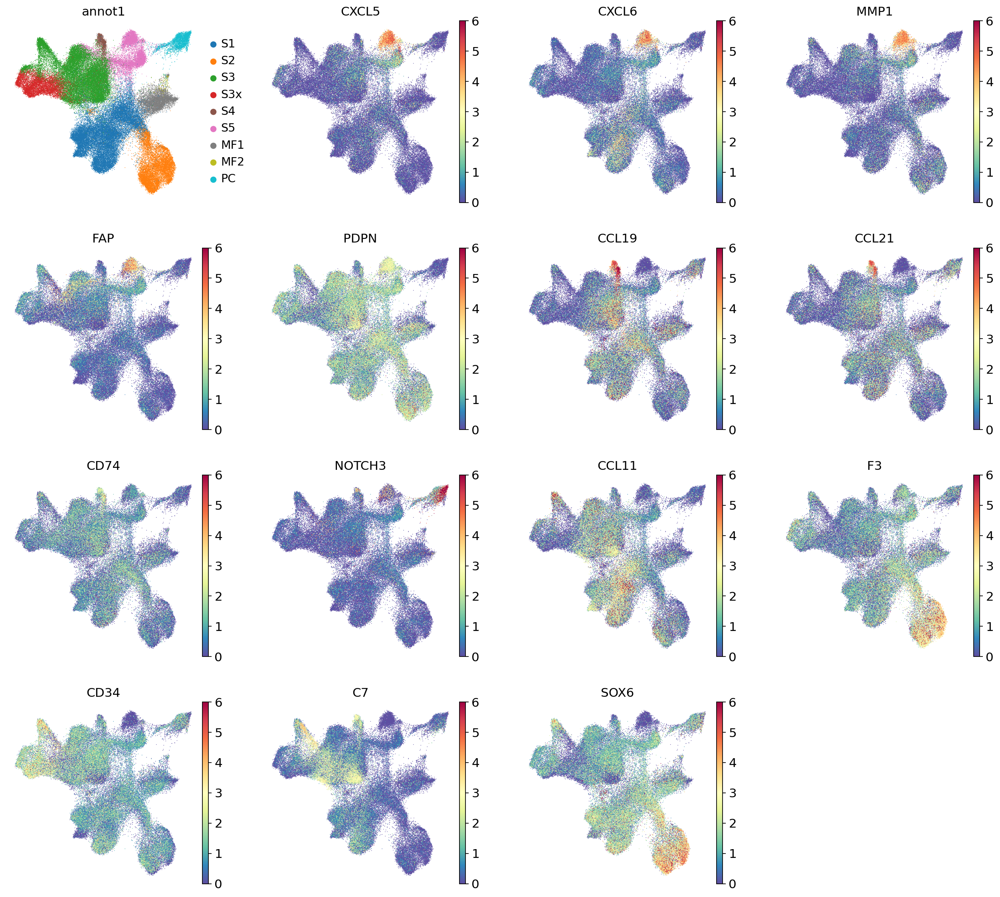

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


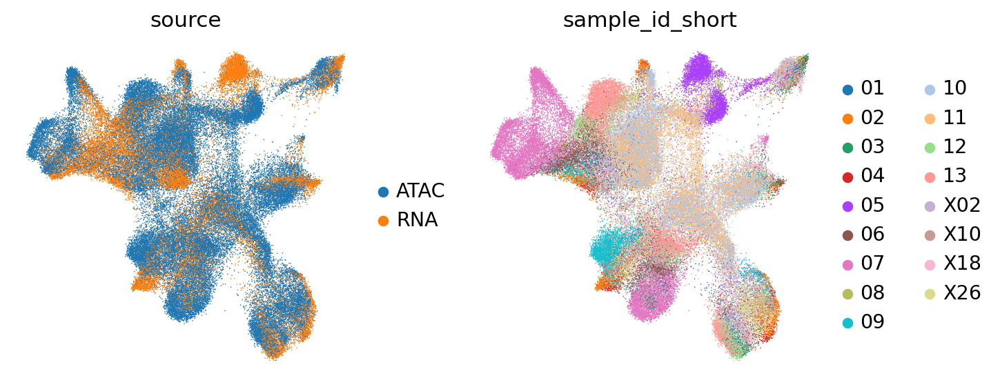

In [63]:
sc.set_figure_params(dpi_save=300)

sc.pl.embedding(
    multimap,
    basis="X_multimap",
    color=['annot1', 'CXCL5', 'CXCL6', 'MMP1', 'FAP', 'PDPN', 'CCL19', 'CCL21', 'CD74', 'NOTCH3', 'CCL11', 'F3', 'CD34', 'C7', 'SOX6'],
    vmax=6,
    palette='tab10',
    frameon=False,
    size=2,  # point size
    #add_outline=True
    #legend_loc='on data',
    #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
    save='_RNA_ATAC_celltype.pdf'
)

sc.pl.embedding(
    multimap,
    basis="X_multimap",
    color=['source', 'sample_id_short'],
    #palette=sc.plotting.palettes.default_28,
    palette=sc.plotting.palettes.default_20,
    frameon=False,
    size=2,  # point size
    #add_outline=True
    #legend_loc='on data',
    save='_RNA_ATAC_source_sample.pdf'  # in ./figures
)

In [64]:
#multimap

In [65]:
#multimap_shuffle

In [66]:
#multimap_shuffle.obs

In [67]:
multimap

AnnData object with n_obs × n_vars = 83416 × 27510
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'TSSEnrichment', 'Clusters', '

In [68]:
# pd.set_option('display.max_rows', 200)
# multimap.obs.dtypes

In [69]:
# Drop columns that are unwritable
#multimap.obs = multimap.obs.drop(['Sample'], axis=1)

In [70]:
#multimap.write_h5ad("data/multimap.h5ad", compression='gzip')

In [71]:
#sce.pp.harmony_integrate(multimap, key='source', basis='X_multimap', adjusted_basis='X_multimap_harmony')

In [72]:
# sc.pl.embedding(
#     multimap,
#     basis="X_multimap_harmony",
#     color=['annot1', 'source', 'sample_id', 'Sample'],
#     palette='tab10',
#     frameon=False,
#     size=2,  # point size
#     #add_outline=True
#     #legend_loc='on data',
#     #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
# )

In [73]:
# # Multimap with peak LSI dimensionality reduction, Harmony batch adjusted from Ni's ArchR project.
# multimap = MultiMAP.Integration([rna, atac], ['X_pca', 'peak_IterativeLSI_harmony'])

# multimap.obs.Sample = multimap.obs.Sample.astype('category')

# # Format RNA vs ATAC column
# multimap.obs['source'] = 'ATAC'
# multimap.obs.loc[multimap.obs.ATAC_SID.astype(str)=='nan', 'source'] = 'RNA'
# multimap.obs['source'] = multimap.obs['source'].astype('category')


In [74]:
# sc.pl.embedding(
#     multimap,
#     basis="X_multimap",
#     color=['annot1', 'source', 'Sample'],
#     palette='tab10',
#     frameon=False,
#     size=2,  # point size
#     #add_outline=True
#     #legend_loc='on data',
#     #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
# )

In [75]:
# # Multimap with peak LSI dimensionality reduction, Harmony batch adjusted.
# multimap = MultiMAP.Integration([rna, atac], ['X_pca', 'peak_IterativeLSI_harmony2'])

# multimap.obs.Sample = multimap.obs.Sample.astype('category')

# # Format RNA vs ATAC column
# multimap.obs['source'] = 'ATAC'
# multimap.obs.loc[multimap.obs.ATAC_SID.astype(str)=='nan', 'source'] = 'RNA'
# multimap.obs['source'] = multimap.obs['source'].astype('category')


In [76]:
# sc.pl.embedding(
#     multimap,
#     basis="X_multimap",
#     color=['annot1', 'source', 'Sample'],
#     palette='tab10',
#     frameon=False,
#     size=2,  # point size
#     #add_outline=True
#     #legend_loc='on data',
#     #save='UMAP_RNA_fibroblast_MF_PC_outline.pdf'  # in ./figures
# )

### MultiMAP integration by subtype

In [77]:
#rna.obs.annot1.cat.categories

In [131]:
multimap_sub_dict = {}

for cell_type in rna.obs.annot1.cat.categories:
#for cell_type in ['MF2', 'PC']:
    print(cell_type)
    
    # Get subset of data
    rna_sub = rna[rna.obs.annot1 == cell_type]
    atac_sub = atac[atac.obs.annot1 == cell_type]
    
    try:
        # Multimap with peak LSI dimensionality reduction.
        # but still gene score activity matched by MultiMAP
        multimap_sub = MultiMAP.Integration([rna_sub, atac_sub], ['X_pca', 'peak_IterativeLSI'])

        multimap_sub.obs.Sample = multimap_sub.obs.Sample.astype('category')

        # Format RNA vs ATAC column
        multimap_sub.obs['source'] = np.concatenate([['RNA'] * rna_sub.shape[0], ['ATAC'] * atac_sub.shape[0]])

        multimap_sub.obs['source'] = multimap_sub.obs['source'].astype('category')

        multimap_sub.obs['sample_id_short'] = multimap_sub.obs.sample_id.str.slice(1)
        
        # Shuffle cells for visualization purposes
        multimap_sub = sc.pp.subsample(multimap_sub, fraction=1., copy=True)

        multimap_sub_dict[cell_type] = multimap_sub
    except:
        print("Cell type integration failed")


S1


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


S2


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


S3


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


S3x


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


S4


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


S5


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


MF1


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


MF2


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/numpy/core/fromnumeric.py:3464: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/numpy/core/_methods.py:184: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: Mean of empty slice.
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat 

Cell type integration failed
PC


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/anndata/_core/merge.py:1111: UserWarning: Only some AnnData objects have `.raw` attribute, not concatenating `.raw` attributes.
  warn(


In [132]:
#multimap_sub_dict

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/_settings.py:450: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  IPython.display.set_matplotlib_formats(*ipython_format)
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


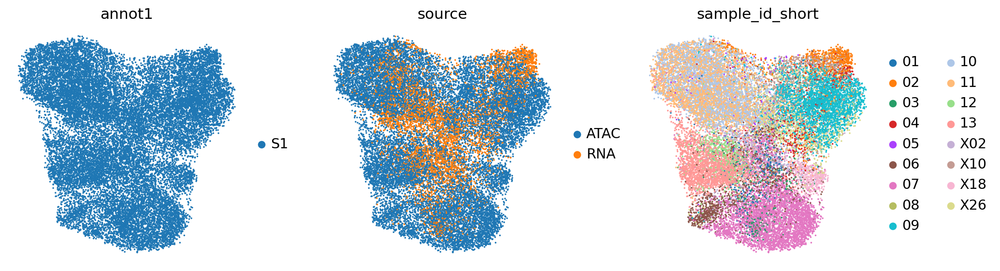

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


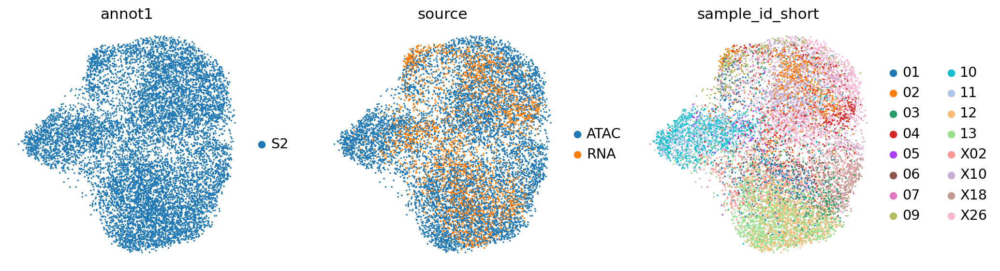

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


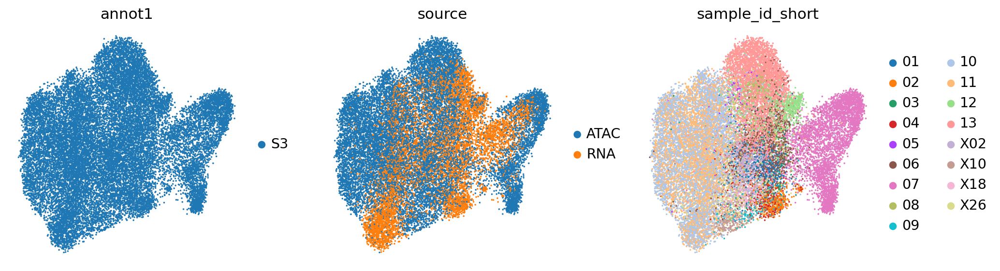

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


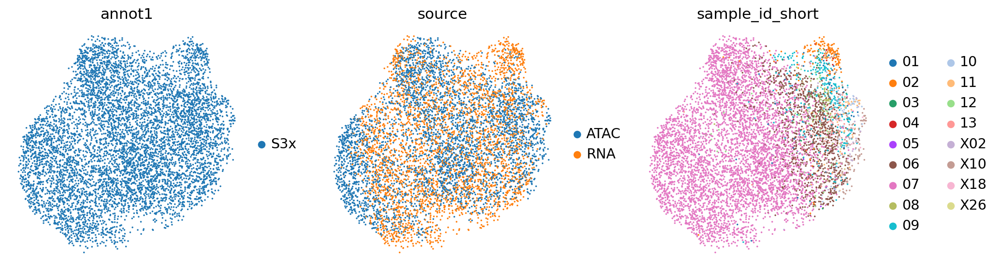

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


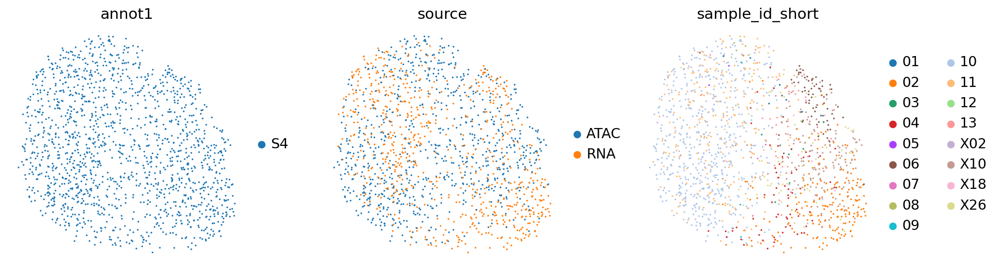

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


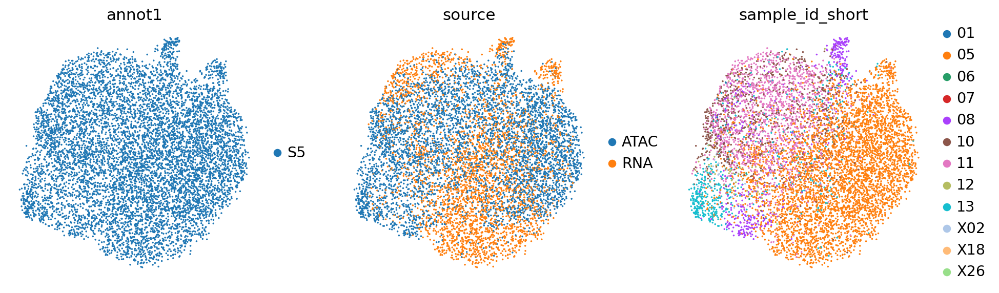

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


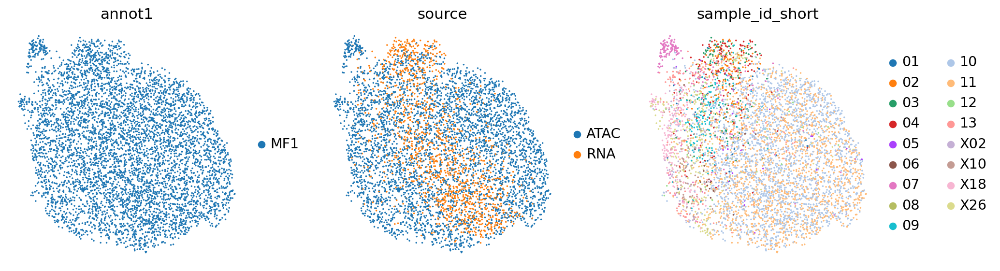

/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


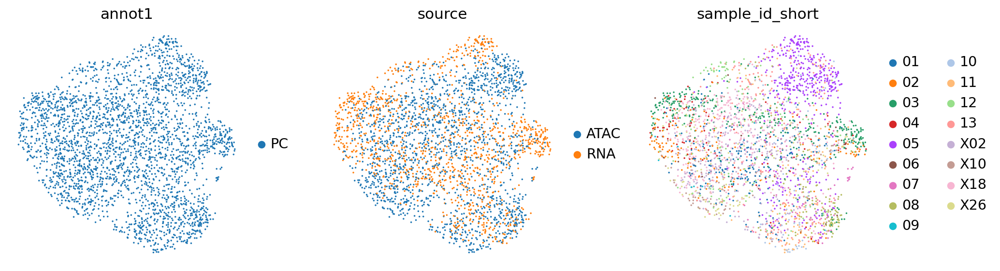

In [133]:
sc.set_figure_params(dpi_save=300)

for cell_type in multimap_sub_dict:
    sc.pl.embedding(
        multimap_sub_dict[cell_type],
        basis="X_multimap",
        color=['annot1', 'source', 'sample_id_short'],
        #palette=sc.plotting.palettes.default_28,
        palette=sc.plotting.palettes.default_20,
        frameon=False,
        size=10,  # point size
        #add_outline=True
        #legend_loc='on data',
        save='_RNA_ATAC_source_sample_' + cell_type + '.pdf'  # in ./figures
    )

# SEACells model

In [134]:
multimap_sub_dict

{'S1': AnnData object with n_obs × n_vars = 23776 × 27510
     obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'TSSEnrichment', 'Clus

S1
Welcome to SEACells!
Computing kNN graph using scanpy NN ...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Computing radius for adaptive bandwidth kernel...


  0%|          | 0/23776 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9a672f580>


  0%|          | 0/23776 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9a54aabe0>


  0%|          | 0/23776 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 311 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 16/16 [00:00<00:00, 51.65it/s]


Selecting 6 cells from greedy initialization.


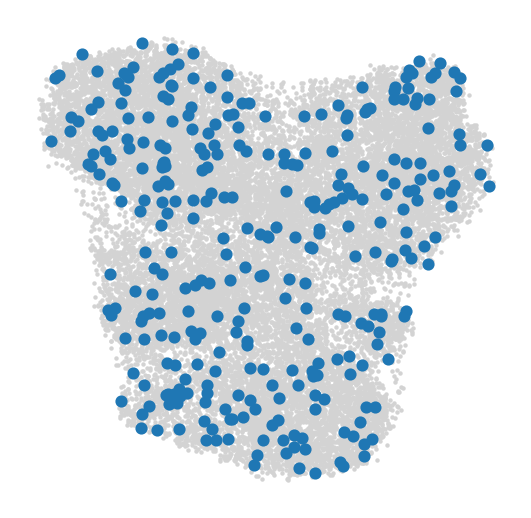

Randomly initialized A matrix.
Setting convergence threshold at 0.00301
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Starting iteration 40.
Completed iteration 40.
Converged after 44 iterations.


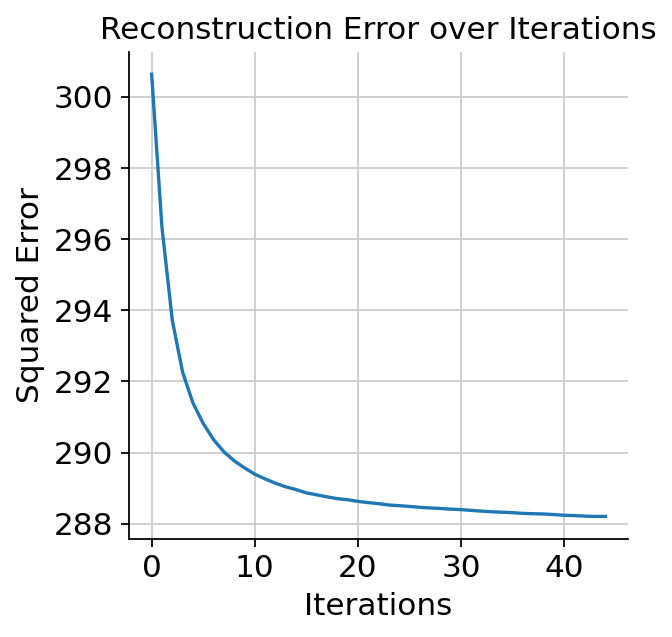

S2
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/10481 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9a7429220>


  0%|          | 0/10481 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb985783d60>


  0%|          | 0/10481 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 131 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 19/19 [00:00<00:00, 131.74it/s]


Selecting 9 cells from greedy initialization.


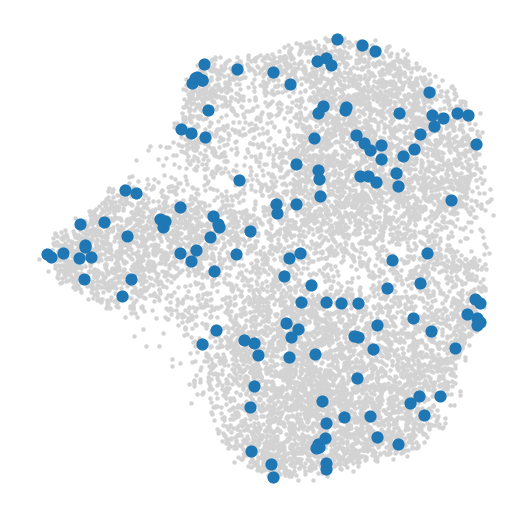

Randomly initialized A matrix.
Setting convergence threshold at 0.00199
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Starting iteration 40.
Completed iteration 40.
Converged after 42 iterations.


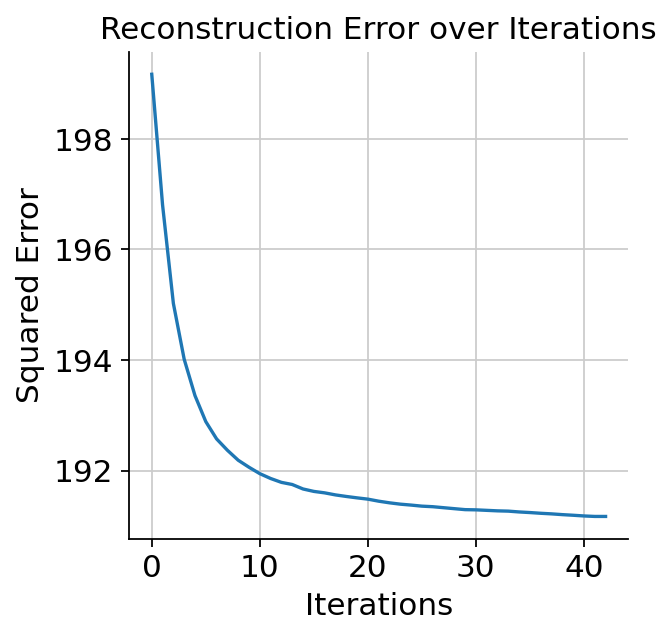

S3
Welcome to SEACells!
Computing kNN graph using scanpy NN ...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


Computing radius for adaptive bandwidth kernel...


  0%|          | 0/24086 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9e0039d00>


  0%|          | 0/24086 [00:00<?, ?it/s]

sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9a54daa60>


Building similarity LIL matrix...


  0%|          | 0/24086 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 311 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 20/20 [00:00<00:00, 45.74it/s]


Selecting 10 cells from greedy initialization.


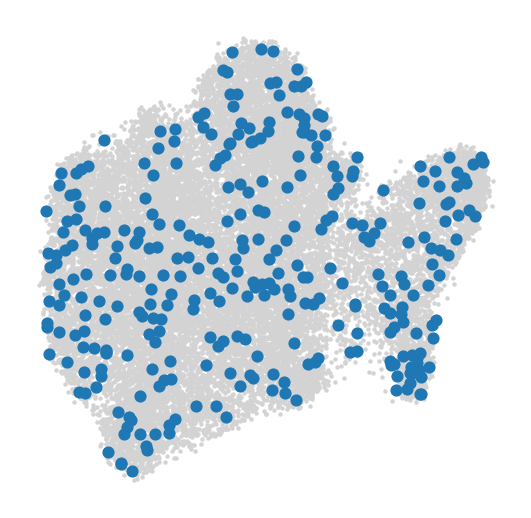

Randomly initialized A matrix.
Setting convergence threshold at 0.00302
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Converged after 34 iterations.


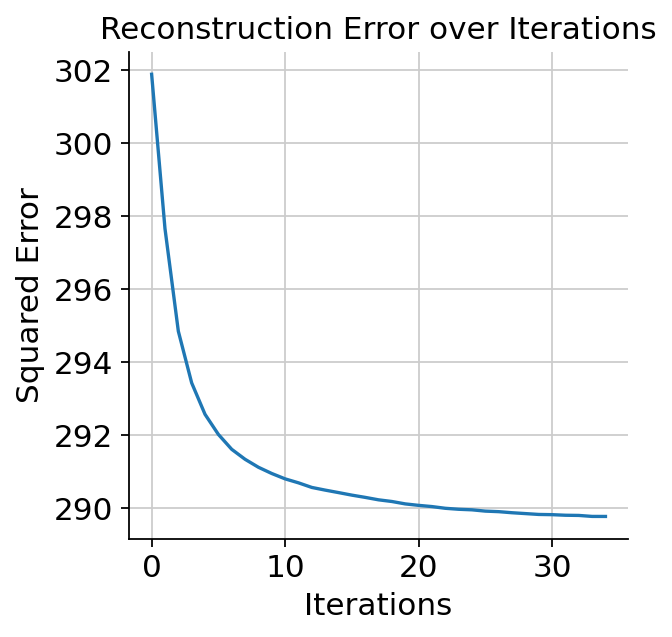

S3x
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/6994 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9a42688e0>


  0%|          | 0/6994 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9f28658e0>


  0%|          | 0/6994 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 90 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 13/13 [00:00<00:00, 368.20it/s]

Selecting 3 cells from greedy initialization.


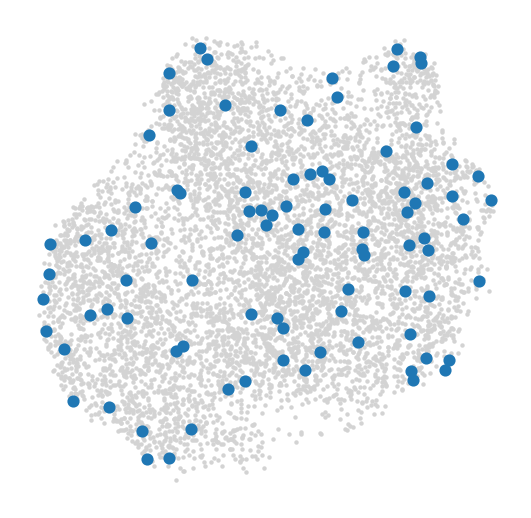

Randomly initialized A matrix.
Setting convergence threshold at 0.00163
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Converged after 35 iterations.


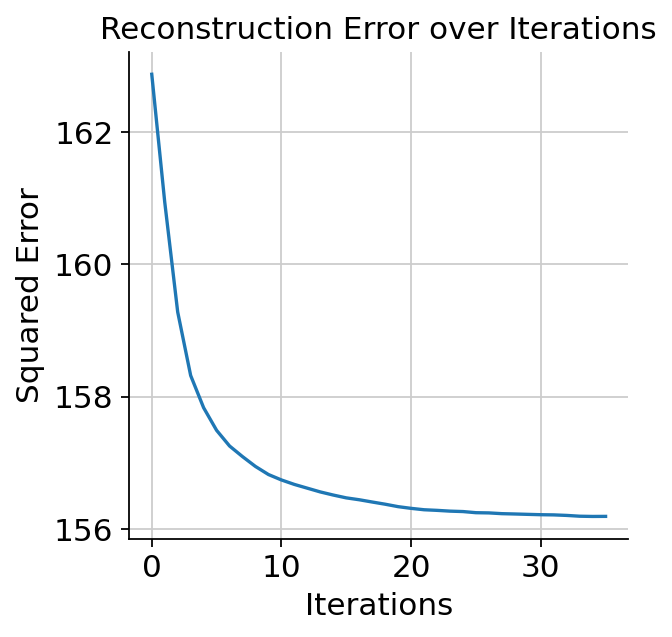

S4
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/1500 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9e00604c0>


  0%|          | 0/1500 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9ac25b760>


  0%|          | 0/1500 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 17 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 13/13 [00:00<00:00, 1178.15it/s]

Selecting 3 cells from greedy initialization.


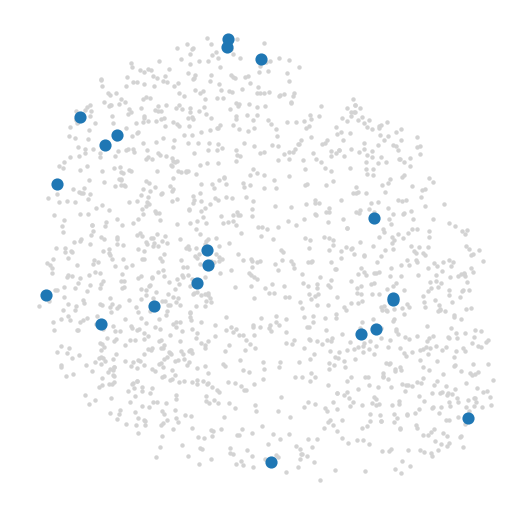

Randomly initialized A matrix.
Setting convergence threshold at 0.00077
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Starting iteration 40.
Completed iteration 40.
Converged after 47 iterations.


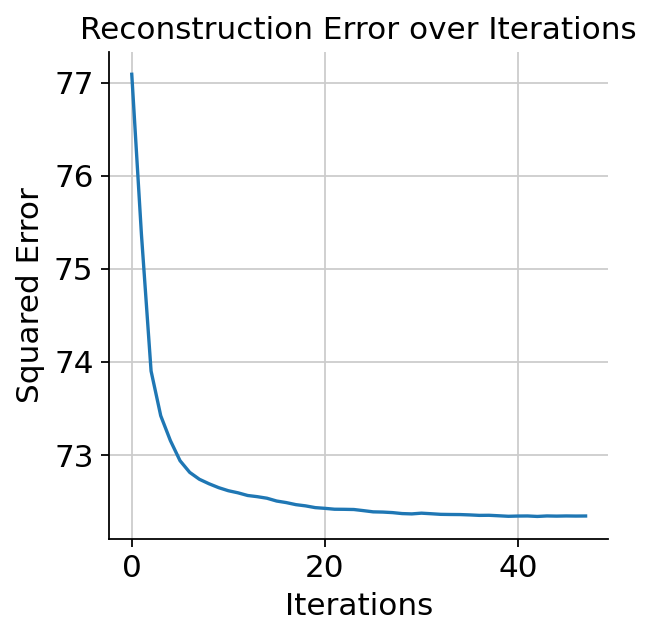

S5
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/7984 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9ac500be0>


  0%|          | 0/7984 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fbb3cbc2e20>


  0%|          | 0/7984 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 95 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 21/21 [00:00<00:00, 305.97it/s]

Selecting 11 cells from greedy initialization.


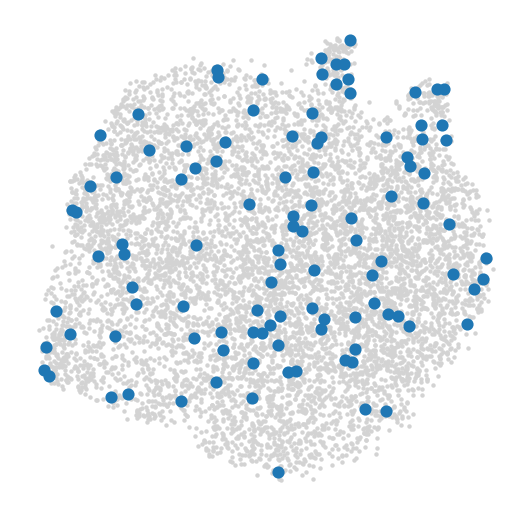

Randomly initialized A matrix.
Setting convergence threshold at 0.00174
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Starting iteration 40.
Completed iteration 40.
Starting iteration 50.
Completed iteration 50.
Converged after 55 iterations.


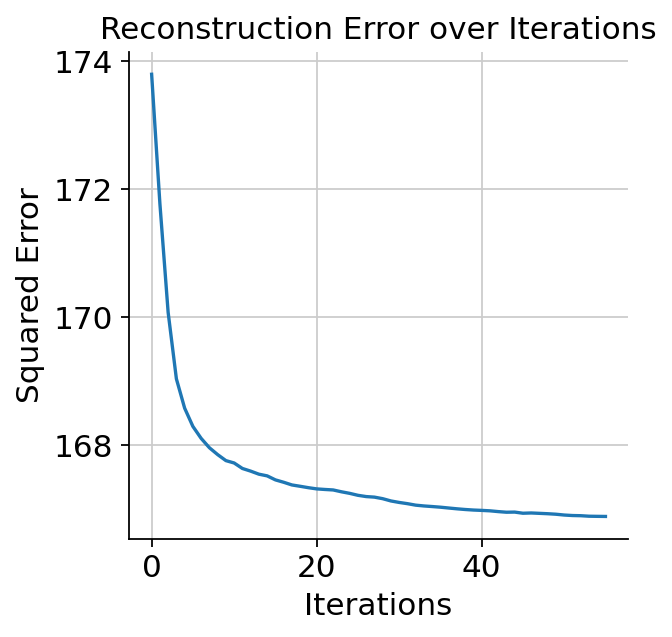

MF1
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/5536 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9f0917640>


  0%|          | 0/5536 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9ac09ba00>


  0%|          | 0/5536 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 68 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 16/16 [00:00<00:00, 410.02it/s]

Selecting 6 cells from greedy initialization.


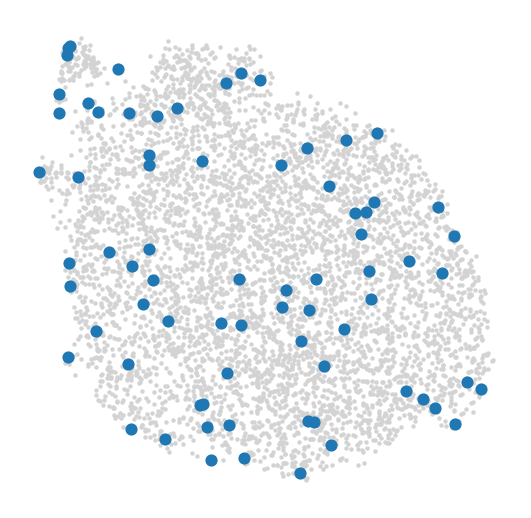

Randomly initialized A matrix.
Setting convergence threshold at 0.00145
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Converged after 28 iterations.


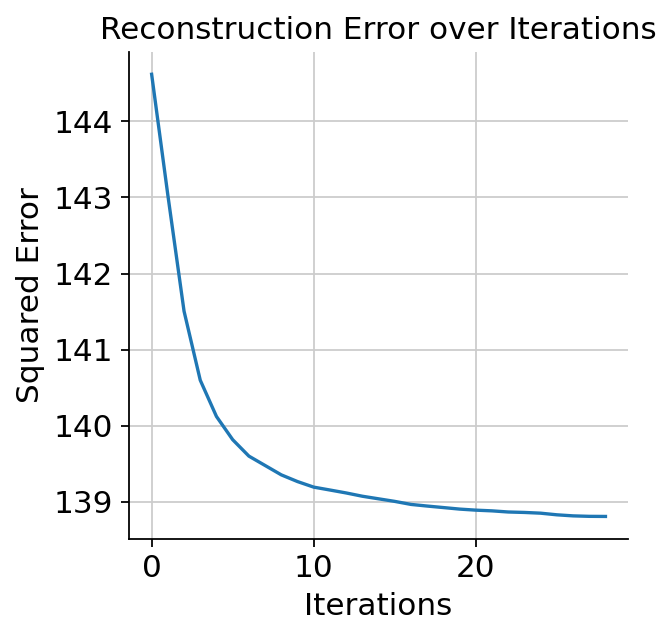

PC
Welcome to SEACells!
Computing kNN graph using scanpy NN ...
Computing radius for adaptive bandwidth kernel...


/home/jovyan/my-conda-envs/seacells/lib/python3.8/site-packages/scipy/sparse/_index.py:146: SparseEfficiencyWarning: Changing the sparsity structure of a csr_matrix is expensive. lil_matrix is more efficient.
  self._set_arrayXarray(i, j, x)


  0%|          | 0/2878 [00:00<?, ?it/s]

Making graph symmetric...
Parameter graph_construction = union being used to build KNN graph...
Computing RBF kernel...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9c051e280>


  0%|          | 0/2878 [00:00<?, ?it/s]

Building similarity LIL matrix...


sys:1: ResourceWarning: Unclosed socket <zmq.Socket(zmq.PUSH) at 0x7fb9ac3eea60>


  0%|          | 0/2878 [00:00<?, ?it/s]

Constructing CSR matrix...
Building kernel on X_multimap
Computing diffusion components from X_multimap for waypoint initialization ... 
Done.
Sampling waypoints ...
Done.
Selecting 34 cells from waypoint initialization.
Initializing residual matrix using greedy column selection
Initializing f and g...


100%|██████████| 14/14 [00:00<00:00, 750.04it/s]

Selecting 4 cells from greedy initialization.


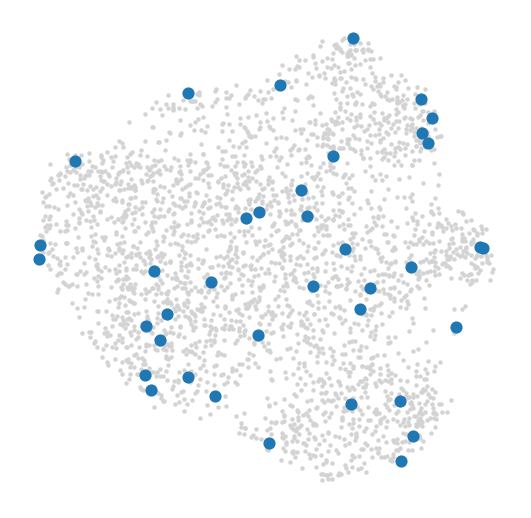

Randomly initialized A matrix.
Setting convergence threshold at 0.00104
Starting iteration 1.
Completed iteration 1.
Starting iteration 10.
Completed iteration 10.
Starting iteration 20.
Completed iteration 20.
Starting iteration 30.
Completed iteration 30.
Converged after 34 iterations.


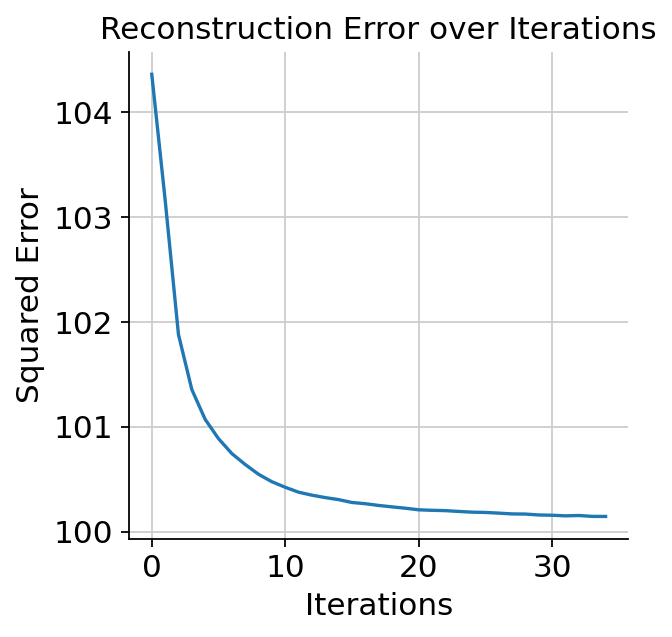

In [135]:
models = {}

for cell_type in multimap_sub_dict:
    print(cell_type)
    
    model = SEACells.core.SEACells(multimap_sub_dict[cell_type], 
                  build_kernel_on='X_multimap',    # key in ad.obsm to use for computing metacells
                  #n_SEACells=200, 
                  n_SEACells=np.round(multimap_sub_dict[cell_type].shape[0] / 75),      # average cells per metacell
                  n_waypoint_eigs=10,   # Number of eigenvalues to consider when initializing metacells
                  convergence_epsilon = 1e-5)
    
    model.construct_kernel_matrix()
    
    # Initialize archetypes
    model.initialize_archetypes()
    
    # Plot the initilization to ensure they are spread across phenotypic space
    SEACells.plot.plot_initialization(multimap_sub_dict[cell_type], model, plot_basis='X_multimap')

    model.fit(min_iter=10, max_iter=100)
    
    # Check for convergence 
    model.plot_convergence()
    
    models[cell_type] = model

In [136]:
# Extract data

In [137]:
warnings.simplefilter(action='ignore', category=UserWarning)

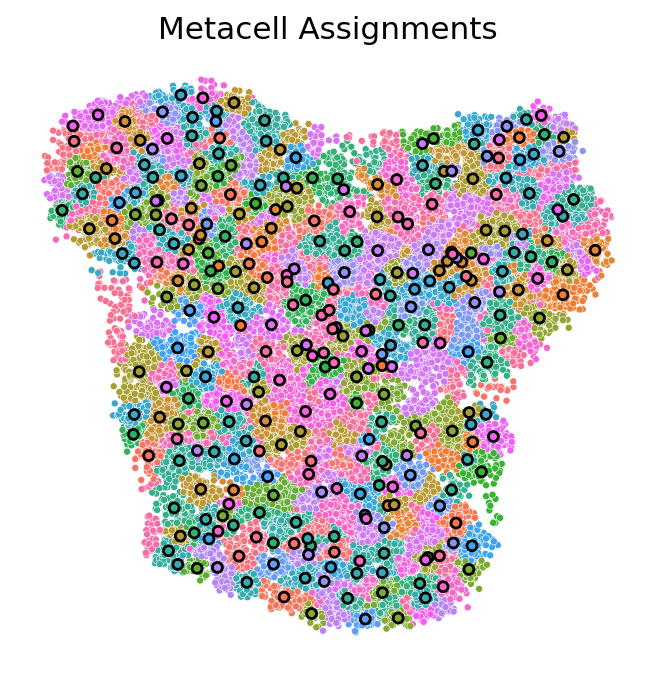

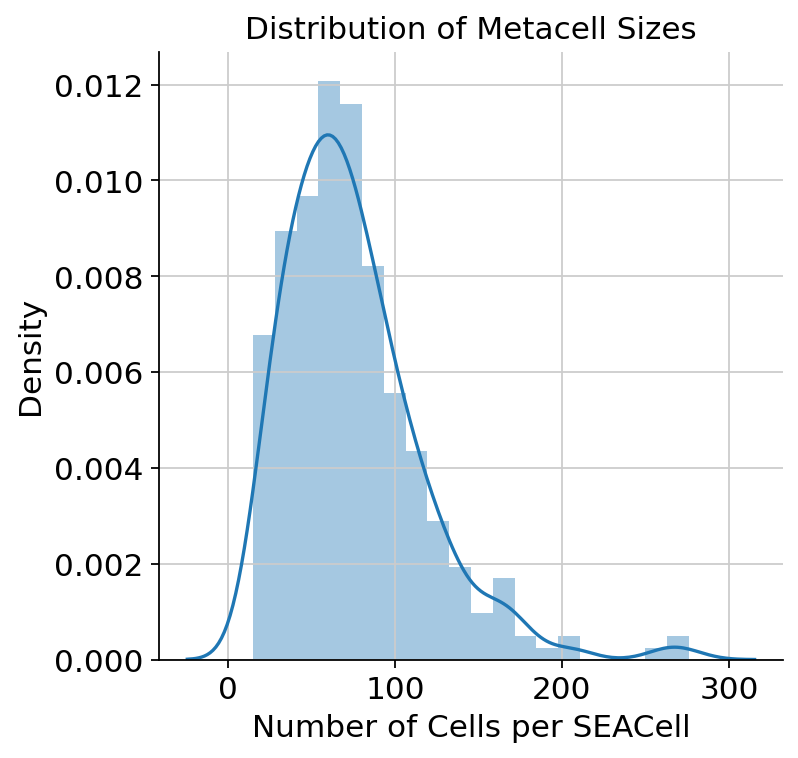

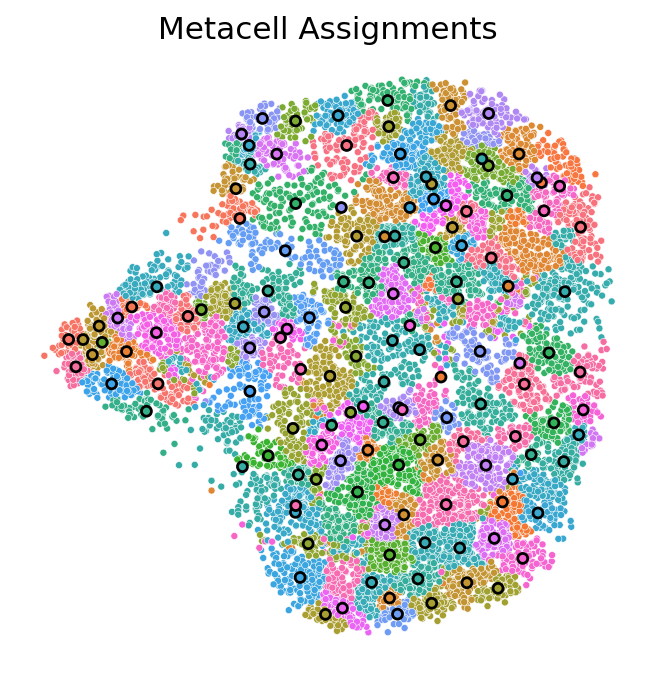

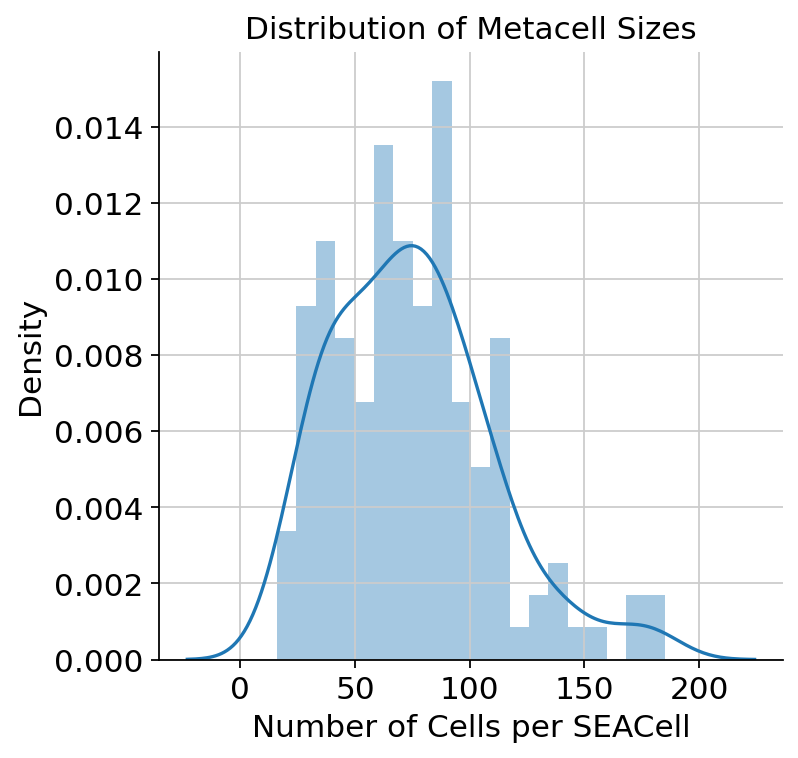

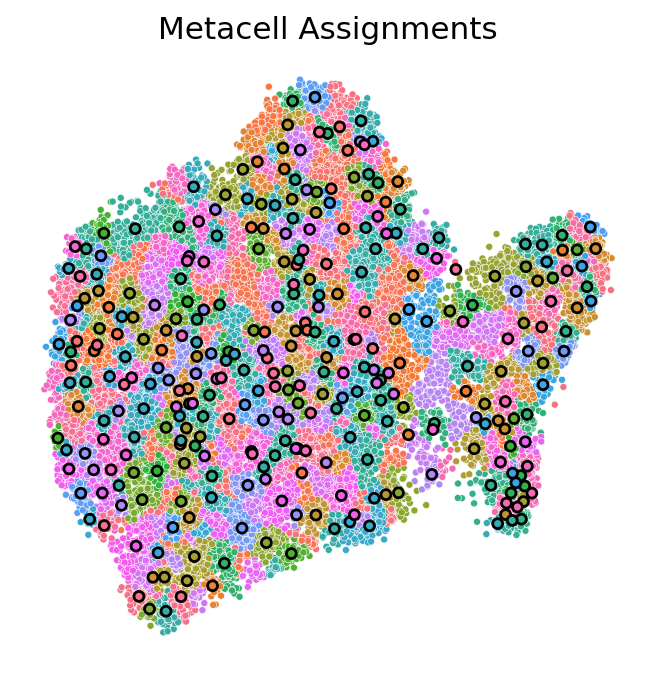

...

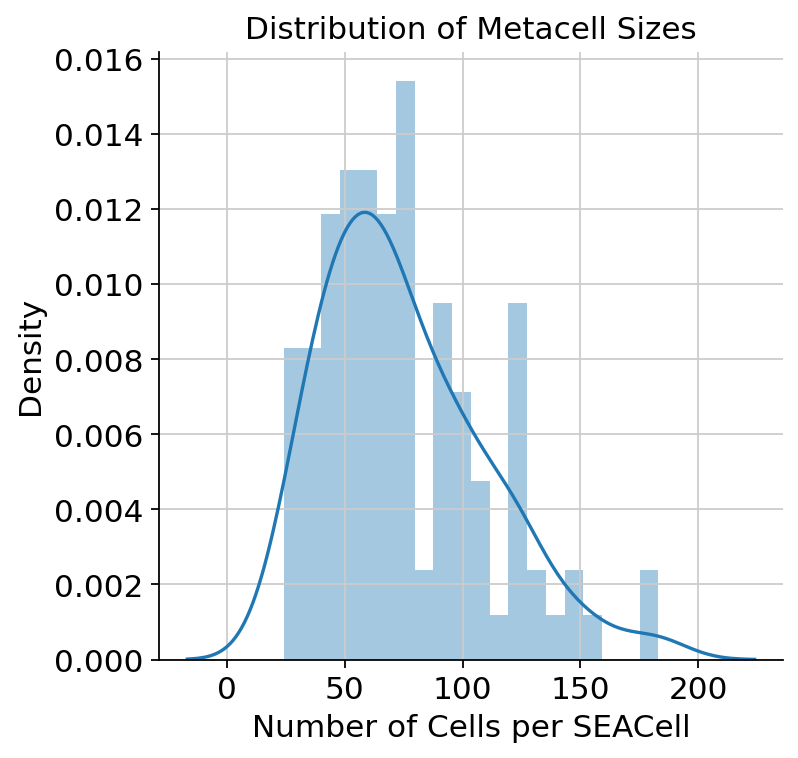

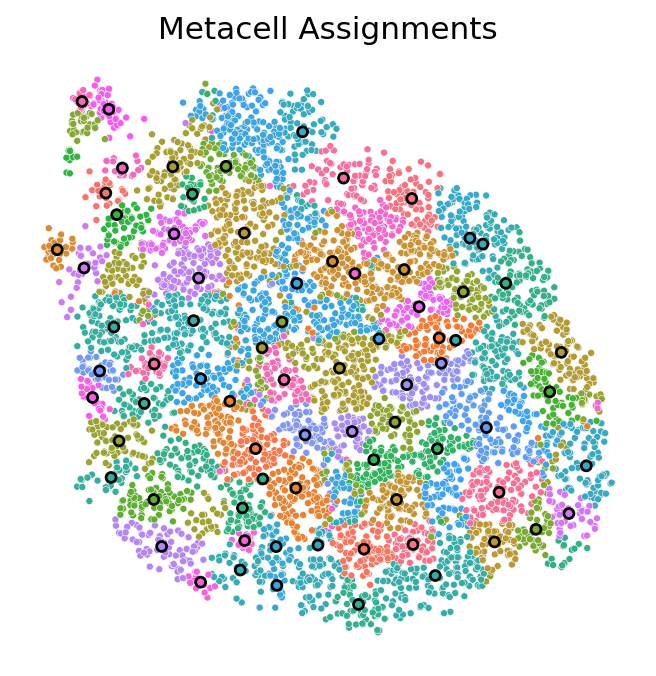

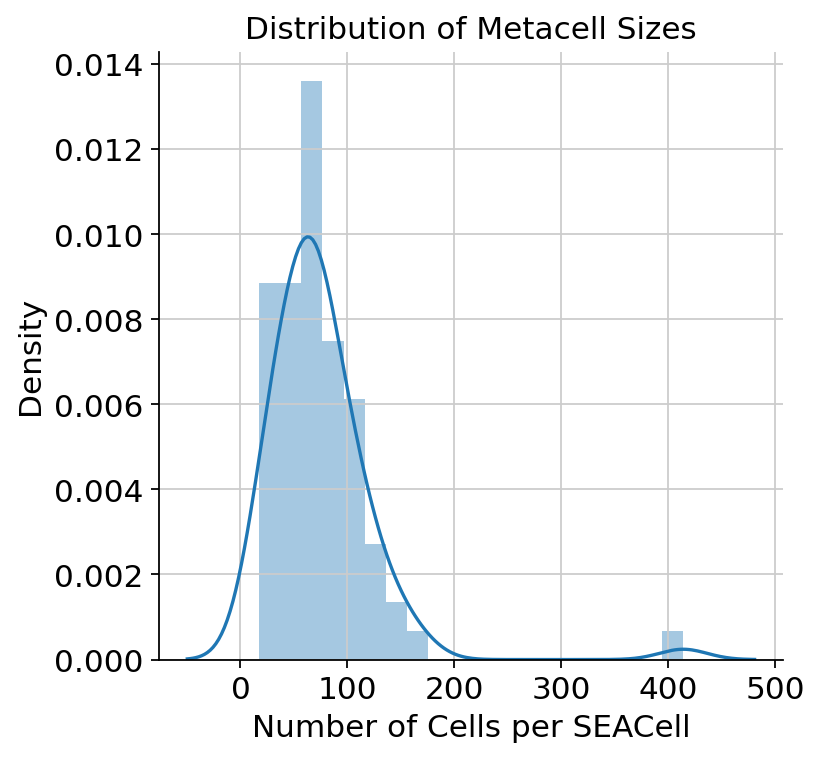

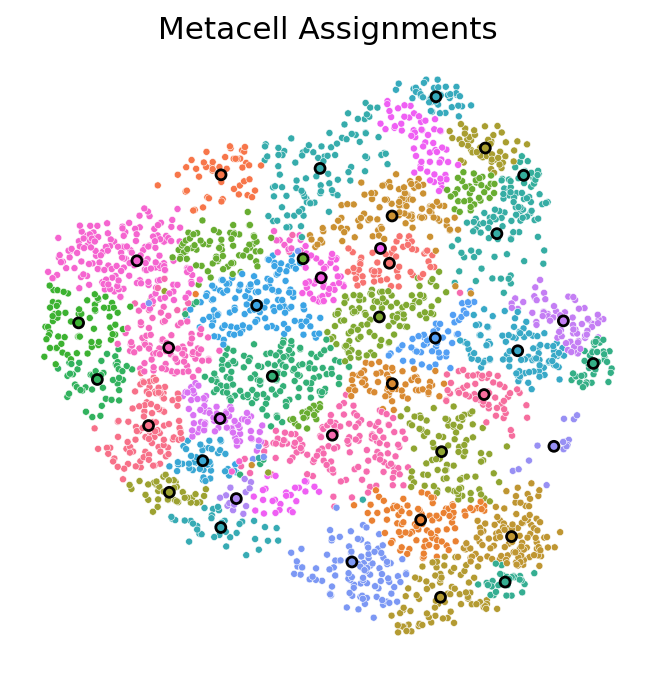

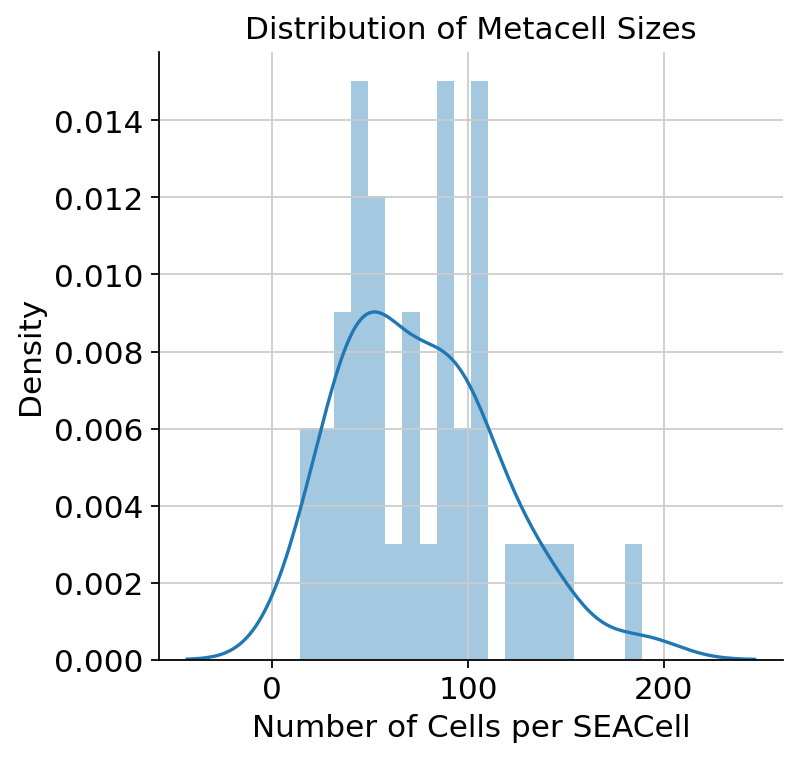

In [138]:
for cell_type in multimap_sub_dict:
    SEACells.plot.plot_2D(multimap_sub_dict[cell_type], key='X_multimap', colour_metacells=True, save_as='figures/metacell_' + cell_type + '.pdf')
    SEACells.plot.plot_SEACell_sizes(multimap_sub_dict[cell_type], bins=20, save_as='figures/metacell_sizes_' + cell_type + '.pdf')

In [139]:
#SEACell_purity = SEACells.evaluate.compute_celltype_purity(multimap_sub_dict[cell_type], 'source')

In [140]:
df = [SEACells.evaluate.compute_celltype_purity(multimap_sub_dict[cell_type], 'source').assign(annot1=cell_type) for cell_type in multimap_sub_dict]
df = pd.concat(df)

In [200]:
df['SEACell_type'] =  df.annot1 + '_' + df.index

In [201]:
df

,source,source_purity,annot1,SEACell_type
SEACell,,,,
SEACell-0,ATAC,0.772727,S1,S1_SEACell-0
SEACell-1,ATAC,0.987654,S1,S1_SEACell-1
SEACell-10,ATAC,0.600000,S1,S1_SEACell-10
SEACell-100,ATAC,0.616162,S1,S1_SEACell-100
SEACell-101,ATAC,0.860759,S1,S1_SEACell-101
...,...,...,...,...
SEACell-5,ATAC,0.653061,PC,PC_SEACell-5
SEACell-6,RNA,0.671958,PC,PC_SEACell-6
SEACell-7,ATAC,0.658824,PC,PC_SEACell-7


In [202]:
df.to_csv("results/SEACells_summary.csv")

In [203]:
df[df.source_purity < 0.9]

,source,source_purity,annot1,SEACell_type
SEACell,,,,
SEACell-0,ATAC,0.772727,S1,S1_SEACell-0
SEACell-10,ATAC,0.600000,S1,S1_SEACell-10
SEACell-100,ATAC,0.616162,S1,S1_SEACell-100
SEACell-101,ATAC,0.860759,S1,S1_SEACell-101
SEACell-103,ATAC,0.789474,S1,S1_SEACell-103
...,...,...,...,...
SEACell-5,ATAC,0.653061,PC,PC_SEACell-5
SEACell-6,RNA,0.671958,PC,PC_SEACell-6
SEACell-7,ATAC,0.658824,PC,PC_SEACell-7


In [194]:
df[df.source_purity < 0.9].annot1.value_counts()

annot1
S3     207
S1     194
S2     114
S5      93
S3x     88
MF1     42
PC      32
S4      20
Name: count, dtype: int64

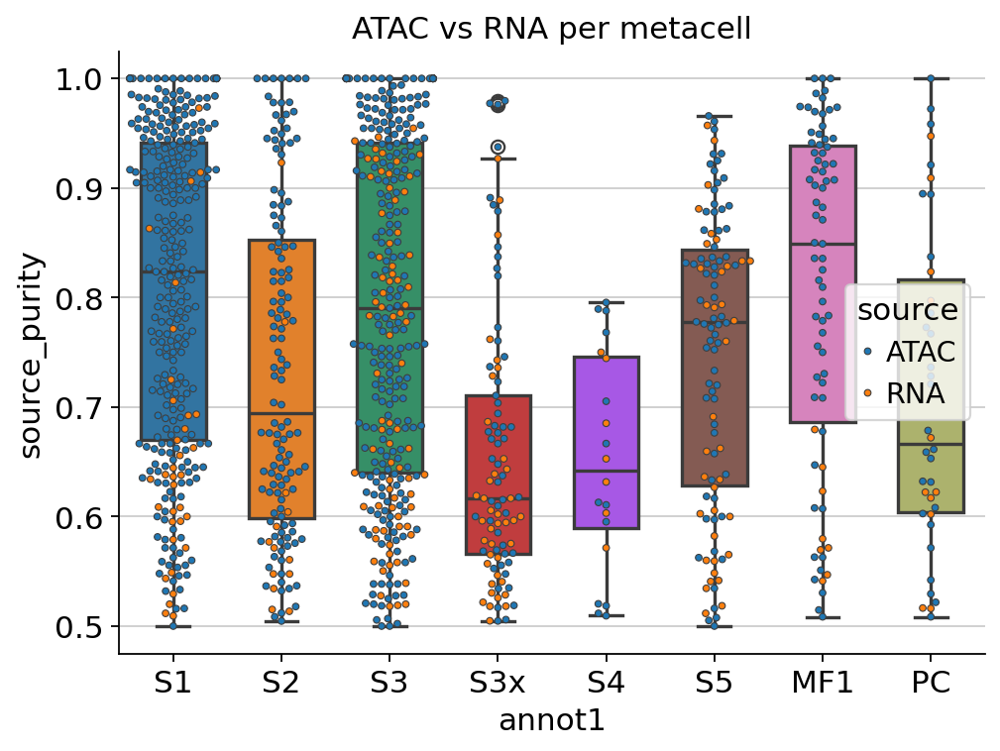

In [191]:
plt.figure(figsize=(7, 5))
ax = sns.boxplot(data=df, y='source_purity', x='annot1', linewidth=1.5, width=0.6, hue='annot1')
ax = sns.swarmplot(data=df, y='source_purity', x='annot1', size=3, hue='source', linewidth=0.5)

plt.title('ATAC vs RNA per metacell')
sns.despine()
plt.show()
plt.close()

ax.get_figure().savefig("figures/SEAcells_purity_by_cell_type.pdf")

#SEACell_purity.head()

In [143]:
multimap_sub_dict[cell_type]

AnnData object with n_obs × n_vars = 2878 × 27510
    obs: 'doublet_bh_pval', 'n_counts', 'sample_id', 'scrublet_score', 'log1p_n_counts', 'n_genes', 'log1p_n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'percent_top50', 'GEX_SID', 'ATAC_SID', 'GEX', 'ATAC', 'Sample', 'DOB', 'Gender', 'date', 'age_years', 'state', 'disease', 'site_taken_fine', 'site_taken_broad', 'sorted', 'Nancy_histologic_score', 'slide_look_other', 'whole_tissue_signature', 'scSeq', 'bulkSeq', 'annot_batch1_lr', 'annot_batch1_lr_prob', 'annot_batch2_lr', 'annot_batch2_lr_prob', 'leiden_bk_r0_1', 'leiden_bk_r0_3', 'leiden_bk_r0_5', 'is_doublet', 'leiden_bk_split1', 'leiden_bk_split2', 'leiden_bk_split3', 'annot1', 'leiden_bk_split4', 'annot_gut_lr', 'annot_gut_lr_prob', 'broad_annot1', 'BlacklistRatio', 'DoubletEnrichment', 'DoubletScore', 'nDiFrags', 'nFrags', 'nMonoFrags', 'nMultiFrags', 'NucleosomeRatio', 'PromoterRatio', 'ReadsInBlacklist', 'ReadsInPromoter', 'ReadsInTSS', 'TSSEnrichment', 'Clusters', 'p

In [144]:
# df_compact = [SEACells.evaluate.compactness(multimap_sub_dict[cell_type], 'X_multimap').assign(annot1=cell_type) for cell_type in multimap_sub_dict]
# df_compact = pd.concat(df_compact)

In [145]:
# df_compact

In [146]:
# plt.figure(figsize=(7, 5))
# ax = sns.boxplot(data=df_compact, y='compactness', x='annot1', linewidth=1.5, width=0.6, hue='annot1')
# #ax = sns.swarmplot(data=df_compact, y='compactness', x='annot1', size=3, color='lightgrey', linewidth=0.5)

# #plt.title('ATAC vs RNA per metacell')
# sns.despine()
# plt.show()
# plt.close()


In [147]:
seacells = [cell_type  + '_' + multimap_sub_dict[cell_type].obs.SEACell for cell_type in multimap_sub_dict]
seacells = pd.concat(seacells)

In [197]:
seacells

index
A09#GAGAACGTCCCAATGA-1     S1_SEACell-134
A07#AGTGTACCACACATTG-1      S1_SEACell-61
GATCATGCAGTCTACA-R04        S1_SEACell-94
A11#GAATCTGAGAGCAGCT-1      S1_SEACell-66
A07#ACAATCGGTACCCACG-1     S1_SEACell-251
                                ...      
GGTGAAGCACAAGCCC-R04        PC_SEACell-20
CAACCAACAATACGAA-R05         PC_SEACell-4
A05#ACCATCCTCTTAAGCG-1      PC_SEACell-24
NX18#CTCACCACAATAGTGA-1     PC_SEACell-22
NX18#GGGTGTCAGTGCTAGG-1      PC_SEACell-2
Name: SEACell, Length: 83235, dtype: object

In [149]:
obs = pd.concat([multimap_sub_dict[cell_type].obs for cell_type in multimap_sub_dict])

In [150]:
obs['SEACell_type'] = obs.annot1 + '_' + obs.SEACell

In [151]:
obs

,doublet_bh_pval,n_counts,sample_id,scrublet_score,log1p_n_counts,n_genes,log1p_n_genes,percent_mito,percent_ribo,percent_hb,percent_top50,GEX_SID,ATAC_SID,GEX,ATAC,Sample,DOB,Gender,date,age_years,state,disease,site_taken_fine,site_taken_broad,sorted,Nancy_histologic_score,slide_look_other,whole_tissue_signature,scSeq,bulkSeq,annot_batch1_lr,annot_batch1_lr_prob,annot_batch2_lr,annot_batch2_lr_prob,leiden_bk_r0_1,leiden_bk_r0_3,leiden_bk_r0_5,is_doublet,leiden_bk_split1,leiden_bk_split2,leiden_bk_split3,annot1,leiden_bk_split4,annot_gut_lr,annot_gut_lr_prob,broad_annot1,BlacklistRatio,DoubletEnrichment,DoubletScore,nDiFrags,nFrags,nMonoFrags,nMultiFrags,NucleosomeRatio,PromoterRatio,ReadsInBlacklist,ReadsInPromoter,ReadsInTSS,TSSEnrichment,Clusters,predictedCell_Un,predictedGroup_Un,predictedScore_Un,predictedCell_Co,predictedGroup_Co,predictedScore_Co,Clusters_hm,predictedCell_Un_hm,predictedGroup_Un_hm,predictedScore_Un_hm,predictedCell_Co_hm,predictedGroup_Co_hm,predictedScore_Co_hm,predictedCell,predictedGroup,predictedScore,Annot,source,sample_id_short,SEACell,SEACell_type
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
A09#GAGAACGTCCCAATGA-1,NaN,NaN,A09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A09,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,S1,NaN,NaN,NaN,NaN,0.004846,1.300000,-0.0,2706.0,6604.0,3386.0,512.0,0.950384,0.169821,64.0,2243.0,2214.0,11.477,C14,CTCCCAACATTCGATG-R02,S1,0.992984,CAATACGGTCGAGTGA-R04,S1,0.599334,C26,CCCATTGGTAAGTCAA-R09,S1,0.505150,TCACATTTCTAGTTCT-R02,S3,0.477124,GTGAGCCAGTTGGACG-R10,S3,0.545943,S1,ATAC,09,SEACell-134,S1_SEACell-134
A07#AGTGTACCACACATTG-1,NaN,NaN,A07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,S1,NaN,NaN,NaN,NaN,0.004281,0.440000,-0.0,3239.0,9695.0,5970.0,486.0,0.623953,0.165962,83.0,3218.0,2907.0,8.271,C12,GTGGGAAAGGAGGCAG-R04,S1,1.000000,GTGCTGGAGGTGCTGA-R06,S1,0.975276,C23,TGAGTCATCAGGAGAC-R04,S1,0.984460,AAGACTCCAGCGATTT-R06,S1,0.973971,CTAACTTAGGATACAT-R07,S1,1.000000,S1,ATAC,07,SEACell-61,S1_SEACell-61
GATCATGCAGTCTACA-R04,0.914225,9087.0,R04,0.084211,9.114710,2944.0,7.987864,4.258831,21.118080,0.011005,28.205128,R04,A04,GX70,NX26,110560,6/1/1987,F,5/7/2018,31.0,non-inflamed,CD,ascending colon,large intestine,CD45-EPCAM-CD31-THY1+PDPN+,0.0,normal,im,RNA+ATAC,ATAC + CD45+RNA,S1,0.999962,S1,0.999931,1,2,1,False,1,1,1,S1,1,WNT2B+ Fos-hi,0.440157,S1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,RNA,04,SEACell-94,S1_SEACell-94
A11#GAATCTGAGAGCAGCT-1,NaN,NaN,A11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,S1,NaN,NaN,NaN,NaN,0.006370,0.306667,-0.0,4664.0,10597.0,5258.0,675.0,1.015405,0.218081,135.0,4622.0,4358.0,12.399,C23,GAGTTACTCAACTCTT-R02,S1,0.972575,TTCACCGAGAGAGCAA-R10,S1,0.891877,C25,GAGTTACTCAACTCTT-R02,S1,0.818989,GTACAACTCACCATCC-R02,S1,0.887652,GAGTTACTCAACTCTT-R02,S1,0.863891,S1,ATAC,11,SEACell-66,S1_SEACell-66
A07#ACAATCGGTACCCACG-1,NaN,NaN,A07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A07,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,S1,NaN,NaN,NaN,NaN,0.004840,0.106667,-0.0,3711.0,8368.0,3948.0,709.0,1.119554,0.167244,81.0,2799.0,2521.0,10.782,C12,CCAATTTTCTCGTGGG-R06,IM,0.572210,AGCGCCAAGATCCCGC-R03,S1,0.964212,C23,TGCTGAACAGAGCTAG-R07,S1,0.701265,CTAACTTAGGATACAT-R07,S1,0.985004,CTAACTTAGGATACAT-R07,S1,0.674294,S1,ATAC,07,SEACell-251,S1_SEACell-251
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,..

In [152]:
obs.index[obs.source == 'ATAC'].isin(atac.obs.index)

array([ True,  True,  True, ...,  True,  True,  True])

In [183]:
obs.index[obs.source == 'ATAC'].isin(atac.obs.index).all()

True

In [153]:
# Write output
obs[['source', 'annot1', 'sample_id', 'SEACell_type']].to_csv('results/SEACells.csv')

In [184]:
obs.SEACell_type.value_counts()

SEACell_type
S3_SEACell-112    643
S3_SEACell-110    456
MF1_SEACell-52    414
S3_SEACell-102    410
S1_SEACell-94     276
                 ... 
S2_SEACell-120     16
S1_SEACell-205     15
PC_SEACell-34      14
S3x_SEACell-18     13
S3_SEACell-313     13
Name: count, Length: 1109, dtype: int64

### Selected cell type

In [154]:
# cell_type = 'S5'

In [155]:
# model = SEACells.core.SEACells(multimap_sub_dict[cell_type], 
#                   build_kernel_on='X_multimap',    # key in ad.obsm to use for computing metacells
#                   n_SEACells=200, 
#                   n_waypoint_eigs=10,   # Number of eigenvalues to consider when initializing metacells
#                   convergence_epsilon = 1e-5)

In [156]:
# model.construct_kernel_matrix()

In [157]:
# # Initialize archetypes
# model.initialize_archetypes()

In [158]:
#multimap_sub_dict[cell_type].obs.to_numpy()

In [159]:
# # Plot the initilization to ensure they are spread across phenotypic space
# SEACells.plot.plot_initialization(multimap_sub_dict[cell_type], model, plot_basis='X_multimap')

In [160]:
# model.fit(min_iter=10, max_iter=50)

In [161]:
# # Check for convergence 
# model.plot_convergence()

In [162]:
# multimap_sub_dict[cell_type]

In [163]:
# SEACells.plot.plot_2D(multimap_sub_dict[cell_type], key='X_multimap', colour_metacells=True, save_as='figures/metacell_' + cell_type + '.pdf')

In [164]:
# SEACells.plot.plot_SEACell_sizes(multimap_sub_dict[cell_type], bins=20)

In [165]:
# SEACell_purity = SEACells.evaluate.compute_celltype_purity(multimap_sub_dict[cell_type], 'source')

In [166]:
# SEACell_purity

In [167]:
# plt.figure(figsize=(1.5, 5))
# ax = sns.boxplot(data=SEACell_purity, y='source_purity')
# plt.title('ATAC vs RNA purity')
# sns.despine()
# plt.show()
# plt.close()

# #SEACell_purity.head()

## Global
Runs out of memory on 80GB

In [168]:
# del atac, rna
# gc.collect()

In [169]:
# model = SEACells.core.SEACells(multimap, 
#                   build_kernel_on='X_multimap',    # key in ad.obsm to use for computing metacells
#                   n_SEACells=200, 
#                   n_waypoint_eigs=10,   # Number of eigenvalues to consider when initializing metacells
#                   convergence_epsilon = 1e-5)

In [170]:
# model.construct_kernel_matrix()

In [171]:
# # Initialize archetypes
# model.initialize_archetypes()

In [172]:
# multimap

In [173]:
# del multimap.obsm['peak_IterativeLSI_harmony']
# del multimap.obsm['X_umap_ori']
# del multimap.obsm['X_umap_bk']

In [174]:
# del lsi_harmony_mat
# del lsi_mat

In [175]:
# gc.collect()

In [176]:
# # filter genes
# sc.pp.log1p(multimap)
# sc.pp.highly_variable_genes(multimap, n_top_genes=2000, subset=True)

In [177]:
#multimap.X

In [178]:
# # Plot the initilization to ensure they are spread across phenotypic space
# SEACells.plot.plot_initialization(multimap, model, plot_basis='X_multimap')

In [179]:
# model.fit(min_iter=10, max_iter=50)

In [180]:
# # Check for convergence 
# model.plot_convergence()

In [181]:
# SEACells.plot.plot_2D(multimap, key='X_multimap', colour_metacells=True)

In [182]:
# SEACells.plot.plot_SEACell_sizes(multimap, bins=5)

In [196]:
#%ls